In [1]:
#%matplotlib notebook
import sys
sys.path.append("/u/yali/script/Plots")
from Plots import plot_static
from plot_static import plot_single
from Plots import plot_animate
from plot_animate import plots
import numpy as np
import matplotlib.pyplot as plt

In [7]:
a = plot_animate.ani_top("gDisk0", 50, 400)
a

Animation size has reached 21179276 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
b = plot_animate.ani_3d("gDisk5", 45)
b

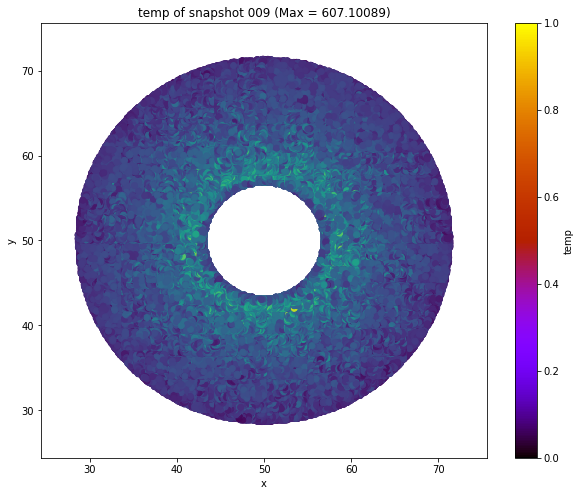

In [7]:
#fig = plt.figure(figsize = (10, 10))
#ax = fig.add_subplot(111, projection='3d')
#ax.view_init(elev=40., azim=40.)
#ax.scatter(a.coordx[a.coordy > 50], a.coordy[a.coordy > 50], a.coordz[a.coordy > 50], s = 0.005)#, c =  a.dens)
#ax.scatter(a.coordx[(a.phi<0.1)&(a.phi>-0.1)], a.coordy[(a.phi<0.1)&(a.phi>-0.1)], a.coordz[(a.phi<0.1)&(a.phi>-0.1)], s = 0.05)
#ax.scatter(a.coordx, a.coordy, a.coordz, s = 0.05)
#plt.scatter(a.coordx[a.coordy > 50], a.coordz[a.coordy > 50], s = 0.8, c = a.dens[a.coordy > 50])
#plt.colorbar()
#plt.xlim(50, 70)
#plt.ylim(49, 69)
a.scatter_qty("xy", "temp")
#a.qty_qty("dens", "specAngMom")

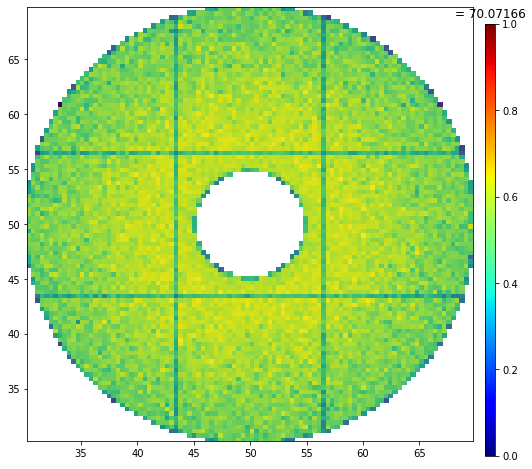

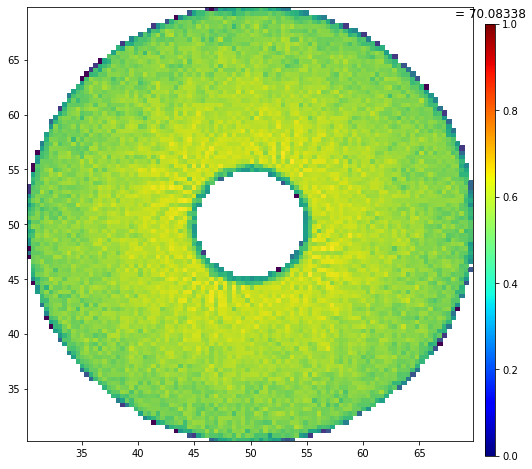

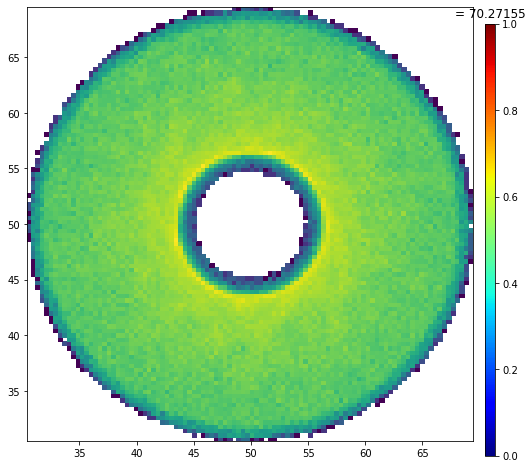

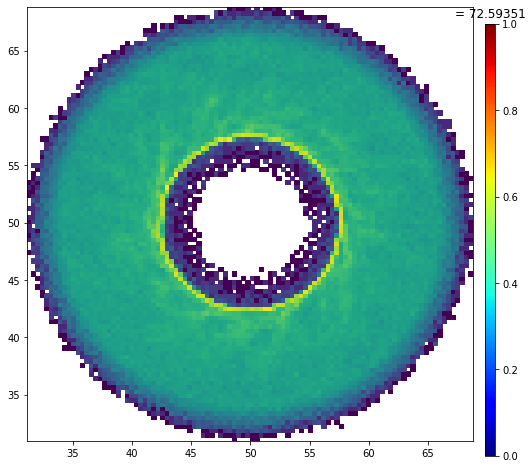

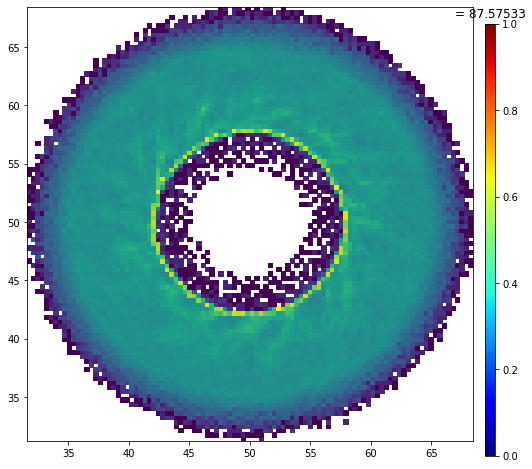

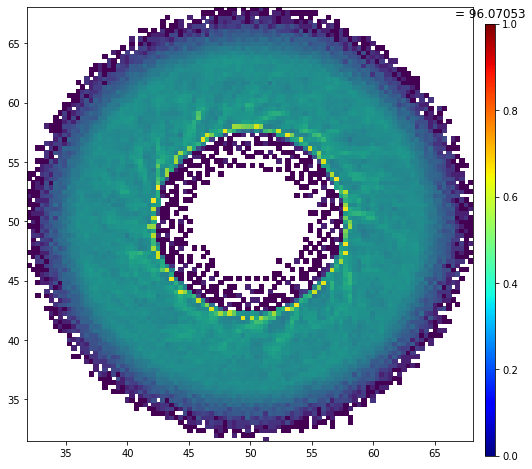

In [28]:
from matplotlib.colors import LogNorm
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import gaussian_kde
import matplotlib as mpl
import sys
import h5py

def draw(i):
    fname = str(format(i, "03d"))
    f = h5py.File("/u/yali/gDisk5/test/output/snapshot_"+fname+".hdf5", 'r')
    coord = f['PartType0']['Coordinates'][:,:]
    coordx = coord[:,0]; coordy = coord[:,1]
    vel = f['PartType0']['Velocities'][:,:]
    velx = vel[:,0]; vely = vel[:,1]
    #dens = f['PartType0']['Density'][:]
    rad = ((coordx-50)**2+(coordy-50)**2)**0.5
    #specAngMom = np.sqrt(G*M_star*rad)#velx * (coordx - 50) + vely * (coordy - 50)
    #points.set_data(np.asarray([rad, specAngMom]))
    fig = plt.figure(figsize = (8,8))
    #plt.hist(specAngMom, 20)
    #plt.hist(rad, 20)
    counts,xbins,ybins,image = plt.hist2d(coordx,coordy,bins=100,norm=LogNorm())
    #plt.legend()
    levels=np.arange(0,20,20)
    norm1 = mpl.colors.Normalize(vmin=0,vmax=1)
    cmap = mpl.cm.jet
    #CSI = plt.contourf(counts.transpose(),extent=[ybins.min(),ybins.max(),xbins.min(),xbins.max()],cmap=cmap,norm=norm1,linewidth=1)
    #plt.contour(counts.transpose(),(30,60,90,120),colors='black',extent=[xbins.min(),xbins.max(),ybins.min(),ybins.max()],linewidths=1,linestyles='solid')
    ax2 = fig.add_axes([0.92, 0.1, 0.018, 0.75])
    mpl.colorbar.ColorbarBase(ax2,cmap=cmap, norm=norm1)
    plt.title('= %.5f'%(np.max(f['PartType0']['InternalEnergy'][:])))
    plt.show()
    plt.close()

draw(0)
draw(10)
draw(20)
draw(30)
draw(34)
draw(37)
#draw(49)

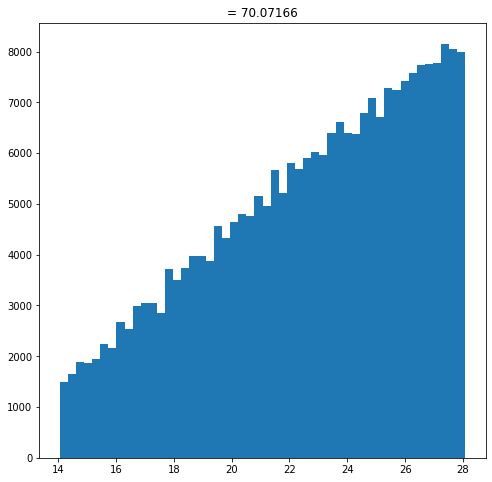

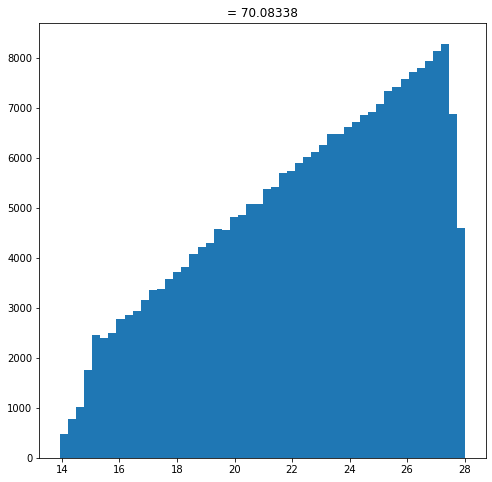

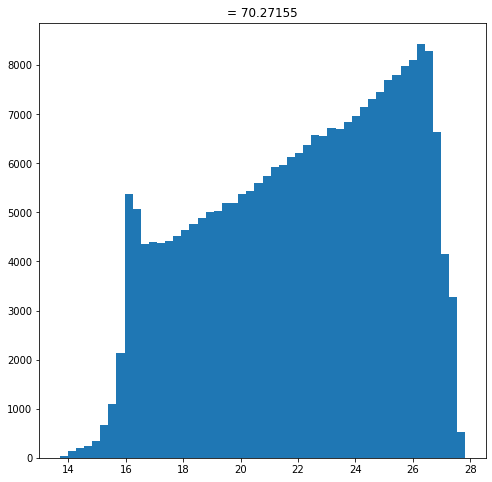

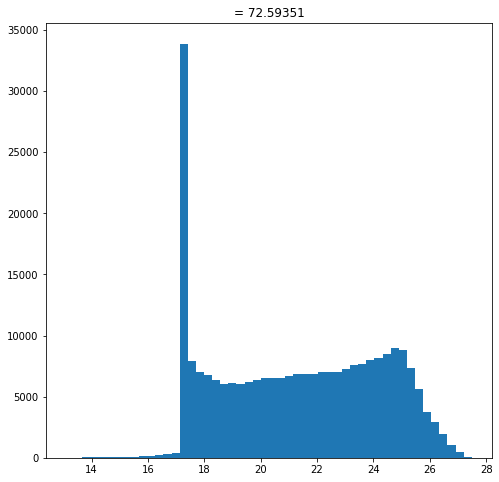

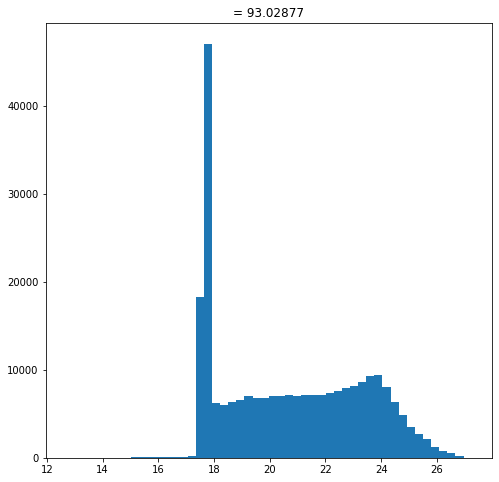

In [30]:
from matplotlib.animation import FuncAnimation
import h5py
import matplotlib.pyplot as plt

G = 39.4429; M_star = 1.0

def draw(i):
    fname = str(format(i, "03d"))
    f = h5py.File("/u/yali/gDisk5/test/output/snapshot_"+fname+".hdf5", 'r')
    coord = f['PartType0']['Coordinates'][:,:]
    coordx = coord[:,0]; coordy = coord[:,1]
    vel = f['PartType0']['Velocities'][:,:]
    velx = vel[:,0]; vely = vel[:,1]
    rad = ((coordx-50)**2+(coordy-50)**2)**0.5
    specAngMom = np.sqrt(G*M_star*rad)#velx * (coordx - 50) + vely * (coordy - 50)
    #points.set_data(np.asarray([rad, specAngMom]))
    plt.figure(figsize = (8,8))
    #plt.hist(specAngMom, 20)
    plt.hist(specAngMom, 50)
    plt.title('= %.5f'%(np.max(f['PartType0']['InternalEnergy'][:])))
    plt.show()
    plt.close()

draw(0)
draw(10)
draw(20)
draw(30)
draw(35)
#draw(40)

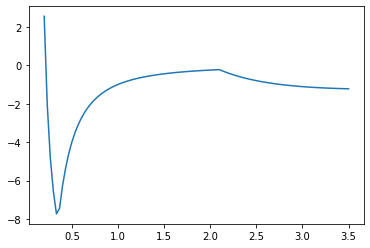

In [12]:
# 2d Keplerian Disk gravity setup

import numpy as np
import matplotlib.pyplot as plt
x = np.linspace(0.2, 3.5, 100)
res = []
for a in x:
    if a < 0.35:
        res.append(1/a**2*(1-a/0.35-(a/0.35)**2))
    elif a > 2.1:
        res.append(-1/a**2*(1+(a-2.1)/0.1))
    else:
        res.append(-1/a**2)
plt.plot(x, res)

In [ ]:

#from Plots import ytplot
#from Plots import ipvplot
#from ipywebrtc import VideoRecorder

 # optionally, we can record the v ideo
    #rec = MediaRecorder(stream=fig)
    #
    #rec.record = False
    
    # record video
#recorder = VideoRecorder(stream=fig)
#recorder 
    
    #recorder.save()
    #ipv.save('viz-3d-stream.html')
    
    #with open('viz-3d-stream.webm', 'wb') as f:
    #    f.write(rec.data)